In [2]:
import pyreadr
import pandas as pd
import seaborn as sns
from IPython.display import display, HTML
from matplotlib import pyplot as plt
import numpy as np

In [3]:
path_to_new_data = "./data/Real_Electronic_Signal_Data_from_Particle_Accelerator_Power_Systems"
system_1="CCL"
system_2="DTL"
system_3="RFQ"
system_4="SCL"
# X= np.load(f'{path_to_new_data}/{system}.npy')   #---> X array has shape: (pulses, times, features)
# Y=np.load(f'{path_to_new_data}/{system}_labels.npy', allow_pickle=True)  #---> Y array has shape: (pulses, labels) --> labels are: index, state, type
# time_steps=np.arange(X.shape[1]) * 400e-9    #create time axis based on the sampling rate 400 ns (for plotting purposes)

CCL_X = np.load(f'{path_to_new_data}/{system_1}.npy')
CCL_Y = np.load(f'{path_to_new_data}/{system_1}_labels.npy', allow_pickle=True)
CCL_time_steps=np.arange(CCL_X.shape[0]*CCL_X.shape[1]) * 400e-9

DTL_X = np.load(f'{path_to_new_data}/{system_2}.npy')
DTL_Y = np.load(f'{path_to_new_data}/{system_2}_labels.npy', allow_pickle=True)
DTL_time_steps=np.arange(DTL_X.shape[1]) * 400e-9

RFQ_X = np.load(f'{path_to_new_data}/{system_3}.npy')
RFQ_Y = np.load(f'{path_to_new_data}/{system_3}_labels.npy', allow_pickle=True)
RFQ_time_steps=np.arange(RFQ_X.shape[1]) * 400e-9

SCL_X = np.load(f'{path_to_new_data}/{system_4}.npy')
SCL_Y = np.load(f'{path_to_new_data}/{system_4}_labels.npy', allow_pickle=True)
SCL_time_steps=np.arange(SCL_X.shape[1]) * 400e-9

In [3]:
len(CCL_X) * 4500

9256500

In [4]:
asdasdsada = pd.DataFrame(CCL_Y, columns=["name", "status", "reason"])
asdasdsada["anomaly"] = asdasdsada.apply(lambda x: 1 if x["status"] == "Fault" else 0, axis=1)
asdasdsada

,name,status,reason,anomaly
0,./CCL1/CCL1_400ns_12_Day_Run_5.28.2022-5.13.27...,Run,Normal,0
1,./CCL1/CCL1_400ns_12_Hour_Run_3.9.2022-2.36.45...,Run,Normal,0
2,./CCL1/CCL1_400ns_12_Hour_Run_5.11.2022-2.10.4...,Run,Normal,0
3,./CCL1/CCL1_400ns_12_Hour_Run_5.13.2022-11.20....,Run,Normal,0
4,./CCL1/CCL1_400ns_12_Hour_Run_5.13.2022-3.34.0...,Run,Normal,0
...,...,...,...,...
2052,./CCL4/CCL4_400ns_Fault_9.11.2020-6.02.55PM.csv,Fault,Fiber Fault,1
2053,./CCL4/CCL4_400ns_Fault_9.26.2021-2.31.02PM.csv,Fault,Interpulse High Fault,1
2054,./CCL4/CCL4_400ns_Fault_9.3.2021-4.17.44PM.csv,Fault,+CB V High Fault,1
2055,./CCL4/CCL4_400ns_Fault_9.5.2021-5.04.18PM.csv,Fault,MOD I High Fault,1


In [5]:
CCL_X_all[0]

NameError: name 'CCL_X_all' is not defined

In [6]:
CCL_X_all.head(10)

NameError: name 'CCL_X_all' is not defined

In [7]:
CCL_Y

array([['./CCL1/CCL1_400ns_12_Day_Run_5.28.2022-5.13.27PM.csv', 'Run',
        'Normal'],
       ['./CCL1/CCL1_400ns_12_Hour_Run_3.9.2022-2.36.45PM.csv', 'Run',
        'Normal'],
       ['./CCL1/CCL1_400ns_12_Hour_Run_5.11.2022-2.10.48AM.csv', 'Run',
        'Normal'],
       ...,
       ['./CCL4/CCL4_400ns_Fault_9.3.2021-4.17.44PM.csv', 'Fault',
        '+CB V High Fault'],
       ['./CCL4/CCL4_400ns_Fault_9.5.2021-5.04.18PM.csv', 'Fault',
        'MOD I High Fault'],
       ['./CCL4/CCL4_400ns_Fault_9.5.2021-7.04.24AM.csv', 'Fault',
        'MOD I High Fault']], dtype=object)

In [8]:
for i in CCL_Y[2000:]:
    print(i[1])
    break

Fault


In [9]:
for i in CCL_X:
    print(i.shape)
    break

(4500, 14)


In [10]:
all_CCL_X_list = []
for i in range(0,len(CCL_X),1):
    tmp_df = pd.DataFrame(CCL_X[i], columns=["a", "b", "c", "d", "e", "f", "g", "h", "i", "j", "k", "l", "m", "n"])
    if CCL_Y[i][1] == "Run":
        tmp_df["pulse_status"] = 0
    elif CCL_Y[i][1] == "Fault":
        tmp_df["pulse_status"] = 1
    else:
        raise ValueError("SOMETHING IS WRONG!!!")
    all_CCL_X_list.append(tmp_df)

CCL_X_all = pd.concat(all_CCL_X_list, axis=0, ignore_index=True)
CCL_Y_all = pd.DataFrame(CCL_Y, columns=["name", "status", "reason"])

# final_df = CCL_X_all.merge(features_xe_gr, on=groupby_cols, how='left')

display(CCL_X_all)
display(CCL_Y_all)

,a,b,c,d,e,f,g,h,i,j,k,l,m,n,pulse_status
0,0.73489,6.13640,9.2801,2.2401,13.929000,9.8489,-0.069420,-0.31591,-0.33798,-716.679993,-0.001011,0.045519,2172.600098,20.622601,0
1,0.73489,8.57780,5.6178,4.6815,13.929000,17.1730,-0.093835,-0.30370,-0.31357,-765.510010,-0.051549,0.045519,2170.100098,5.973300,0
2,3.17640,8.57780,6.8386,4.6815,32.240002,13.5110,-0.118250,-0.27929,-0.31357,-716.679993,-0.026280,0.015000,2170.300049,1.090370,0
3,0.73489,6.13640,6.8386,5.9023,15.150000,9.8489,-0.106040,-0.30370,-0.32578,-643.440002,-0.051549,-0.046037,2171.899902,-3.792600,0
4,4.39710,6.13640,9.2801,5.9023,32.240002,11.0700,-0.093835,-0.29149,-0.33798,-692.260010,-0.001011,0.015000,2172.300049,-6.234100,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9256495,1.72150,-1.42220,-6.3555,-9.5687,-9.621300,4.6815,-0.994340,-4.97400,-4.45890,2106.899902,-3.469600,0.015000,2144.199951,-25.459999,1
9256496,4.16300,-0.20142,-5.1347,-11.9120,-10.964000,2.2401,-1.006500,-5.01060,-4.47110,2151.600098,-3.418600,-0.046037,2143.899902,-15.680000,1
9256497,5.38380,-2.64290,-3.9140,-11.9120,-2.907200,5.9023,-1.043200,-4.99840,-4.48330,2129.300049,-3.444100,-0.107070,2145.699951,-15.690000,1
9256498,0.50081,-2.64290,-7.5762,-10.7410,-6.935600,2.2401,-1.043200,-4.98620,-4.48330,2151.600098,-3.418600,-0.168110,2147.300049,-20.570000,1


,name,status,reason
0,./CCL1/CCL1_400ns_12_Day_Run_5.28.2022-5.13.27...,Run,Normal
1,./CCL1/CCL1_400ns_12_Hour_Run_3.9.2022-2.36.45...,Run,Normal
2,./CCL1/CCL1_400ns_12_Hour_Run_5.11.2022-2.10.4...,Run,Normal
3,./CCL1/CCL1_400ns_12_Hour_Run_5.13.2022-11.20....,Run,Normal
4,./CCL1/CCL1_400ns_12_Hour_Run_5.13.2022-3.34.0...,Run,Normal
...,...,...,...
2052,./CCL4/CCL4_400ns_Fault_9.11.2020-6.02.55PM.csv,Fault,Fiber Fault
2053,./CCL4/CCL4_400ns_Fault_9.26.2021-2.31.02PM.csv,Fault,Interpulse High Fault
2054,./CCL4/CCL4_400ns_Fault_9.3.2021-4.17.44PM.csv,Fault,+CB V High Fault
2055,./CCL4/CCL4_400ns_Fault_9.5.2021-5.04.18PM.csv,Fault,MOD I High Fault


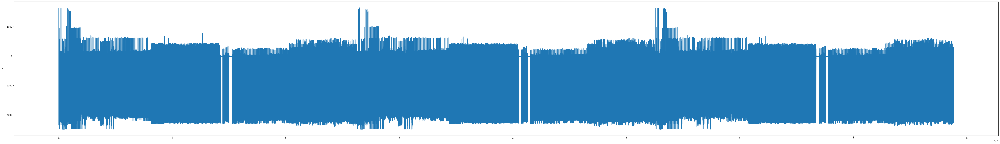

In [12]:
limx = 0
limy = len(CCL_X_all)
px = 1/plt.rcParams['figure.dpi']

fig, ax = plt.subplots(figsize=(7840*px, 1080*px))
fig.patch.set_facecolor((1,1,1,1))
fig.patch.set_alpha(1.0)

plt.plot(CCL_X_all[CCL_X_all["pulse_status"]==0].iloc[limx:limy,0])
plt.savefig("aaaa.png", bbox_inches='tight')

plt.show()

In [27]:
def create_sequences(values, time_steps):
    output = []
    for i in range(len(values) - time_steps + 1):
        print(f"for {i} append values[{i} : {i + time_steps}]")
        output.append(values[i : (i + time_steps)])
    return np.stack(output)

In [32]:
print("50 ds")
CCL_X_all_few = pd.concat(all_CCL_X_list[:1], axis=0, ignore_index=True)
print(CCL_X_all_few.shape)
CCL_X_all_few_0_test = create_sequences(CCL_X_all_few, 11)
print(CCL_X_all_few_0_test.shape)

50 ds
(4500, 15)
for 0 append values[0 : 11]
for 1 append values[1 : 12]
for 2 append values[2 : 13]
for 3 append values[3 : 14]
for 4 append values[4 : 15]
for 5 append values[5 : 16]
for 6 append values[6 : 17]
for 7 append values[7 : 18]
for 8 append values[8 : 19]
for 9 append values[9 : 20]
for 10 append values[10 : 21]
for 11 append values[11 : 22]
for 12 append values[12 : 23]
for 13 append values[13 : 24]
for 14 append values[14 : 25]
for 15 append values[15 : 26]
for 16 append values[16 : 27]
for 17 append values[17 : 28]
for 18 append values[18 : 29]
for 19 append values[19 : 30]
for 20 append values[20 : 31]
for 21 append values[21 : 32]
for 22 append values[22 : 33]
for 23 append values[23 : 34]
for 24 append values[24 : 35]
for 25 append values[25 : 36]
for 26 append values[26 : 37]
for 27 append values[27 : 38]
for 28 append values[28 : 39]
for 29 append values[29 : 40]
for 30 append values[30 : 41]
for 31 append values[31 : 42]
for 32 append values[32 : 43]
for 33 append

In [26]:
print("150 ds")
CCL_X_all_few = pd.concat(all_CCL_X_list[:150], axis=0, ignore_index=True)
print(CCL_X_all_few.shape)
CCL_X_all_few_0_test = create_sequences(CCL_X_all_few, 10)
print(CCL_X_all_few_0_test.shape)
print()
print("81 ds")
CCL_X_all_few = pd.concat(all_CCL_X_list[:81], axis=0, ignore_index=True)
print(CCL_X_all_few.shape)
CCL_X_all_few_0_test = create_sequences(CCL_X_all_few, 10)
print(CCL_X_all_few_0_test.shape)
print()
print("50 ds")
CCL_X_all_few = pd.concat(all_CCL_X_list[:50], axis=0, ignore_index=True)
print(CCL_X_all_few.shape)
CCL_X_all_few_0_test = create_sequences(CCL_X_all_few, 10)
print(CCL_X_all_few_0_test.shape)

150 ds
(675000, 15)
(674991, 10, 15)

81 ds
(364500, 15)
(364491, 10, 15)

50 ds
(225000, 15)
(224991, 10, 15)


In [22]:
print(CCL_X.shape)
print(CCL_X[0].shape)
print(CCL_X_all.shape)
CCL_X_0_test = create_sequences(CCL_X[0], 10)
CCL_X_0_all_test = create_sequences(CCL_X_all, 10)
print(CCL_X_0_test.shape)
print(CCL_X_0_all_test.shape)

(2057, 4500, 14)
(4500, 14)
(9256500, 15)
(4491, 10, 14)
(9256491, 10, 15)


In [1]:
CCL_X_all

NameError: name 'CCL_X_all' is not defined

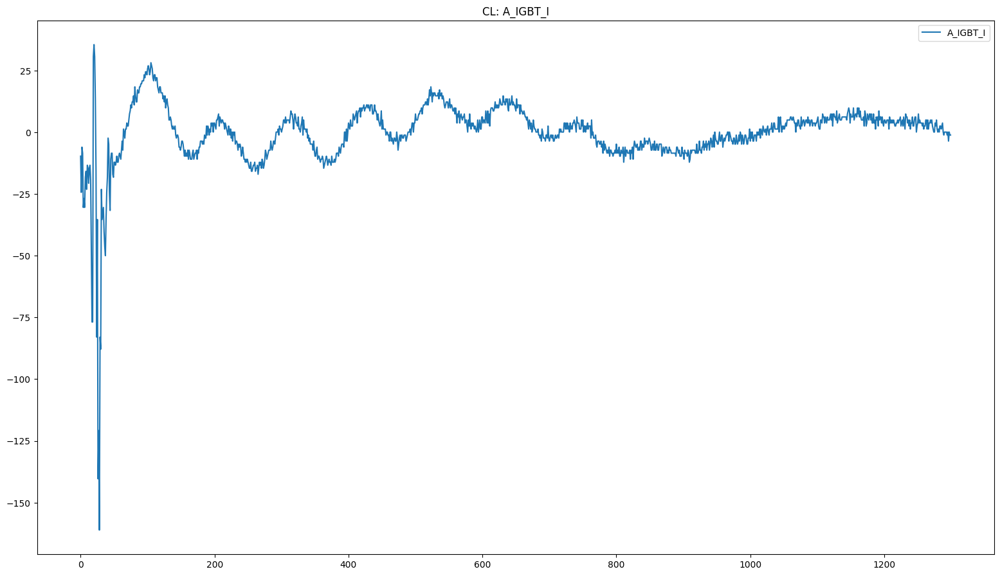

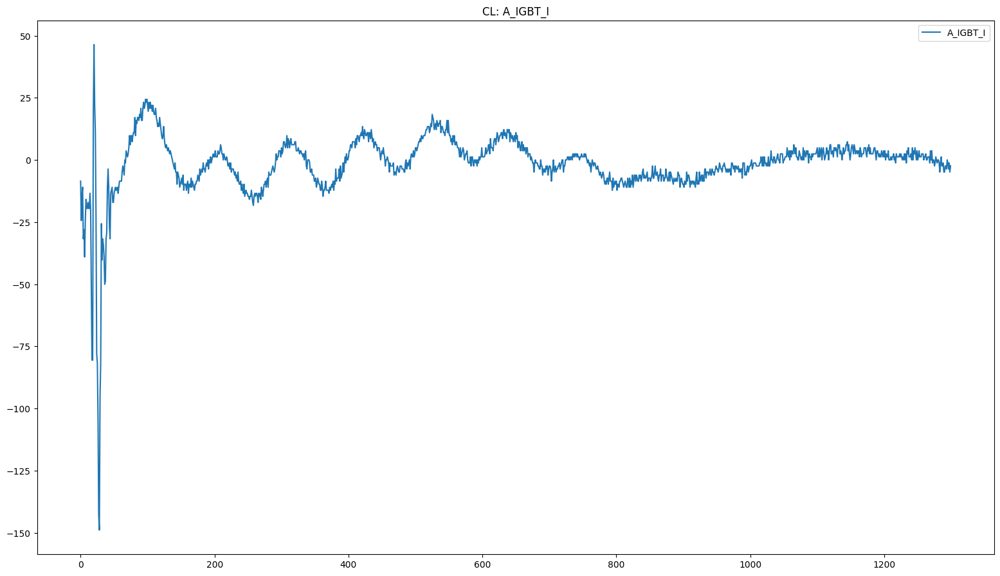

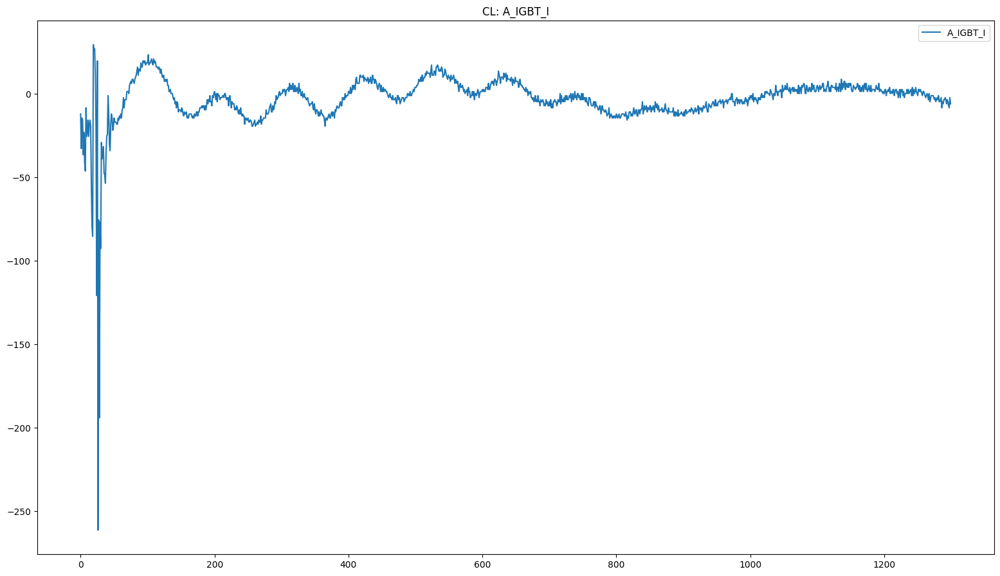

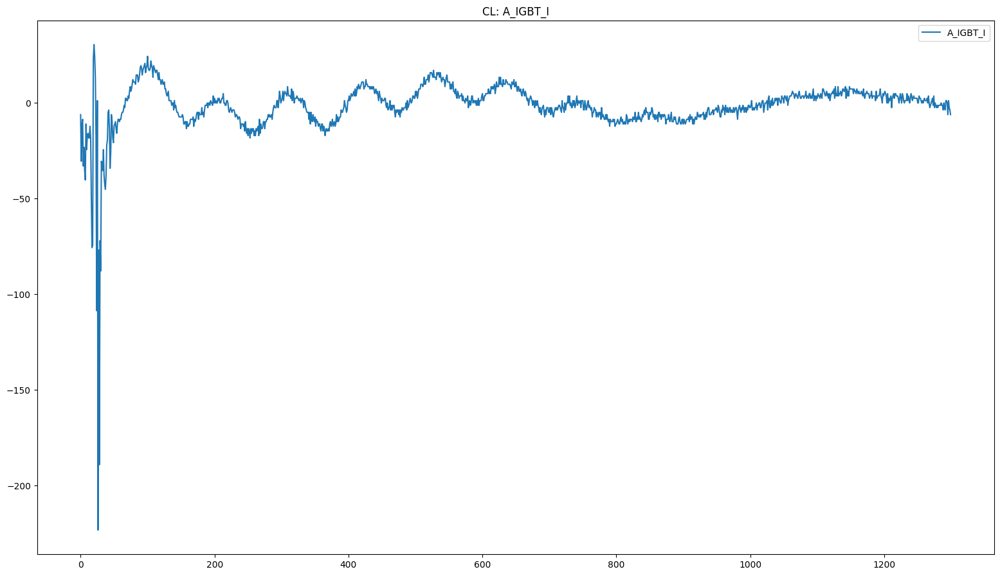

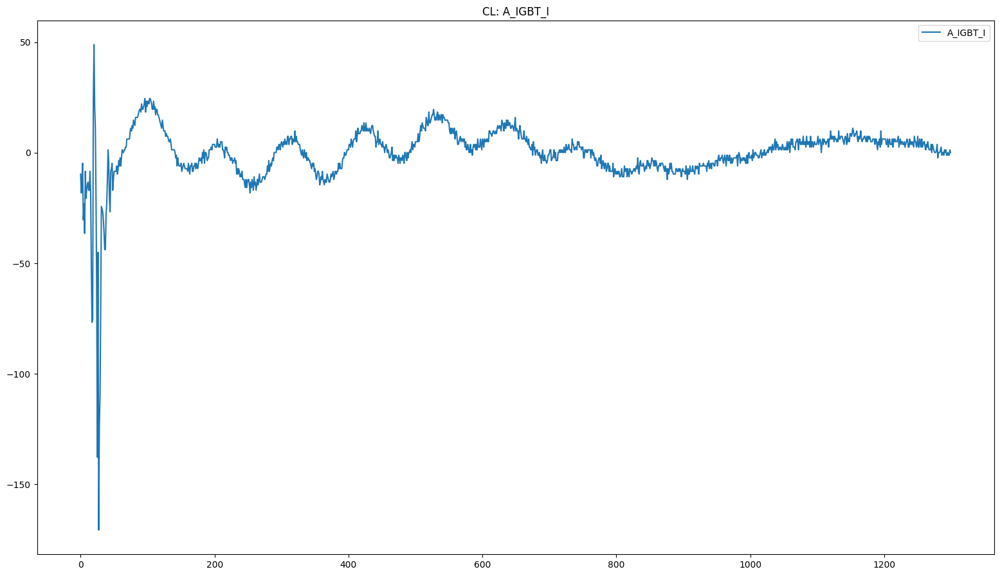

...

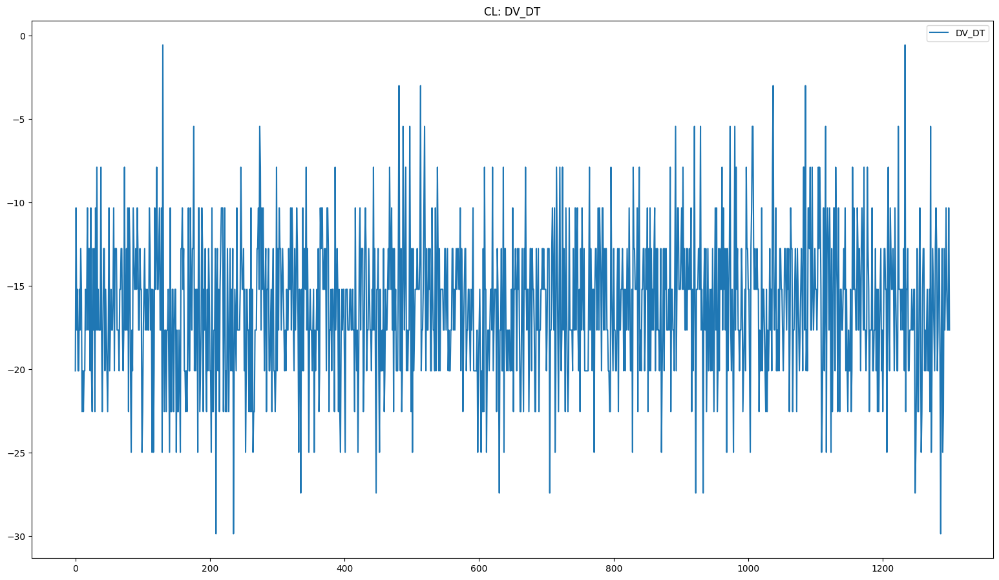

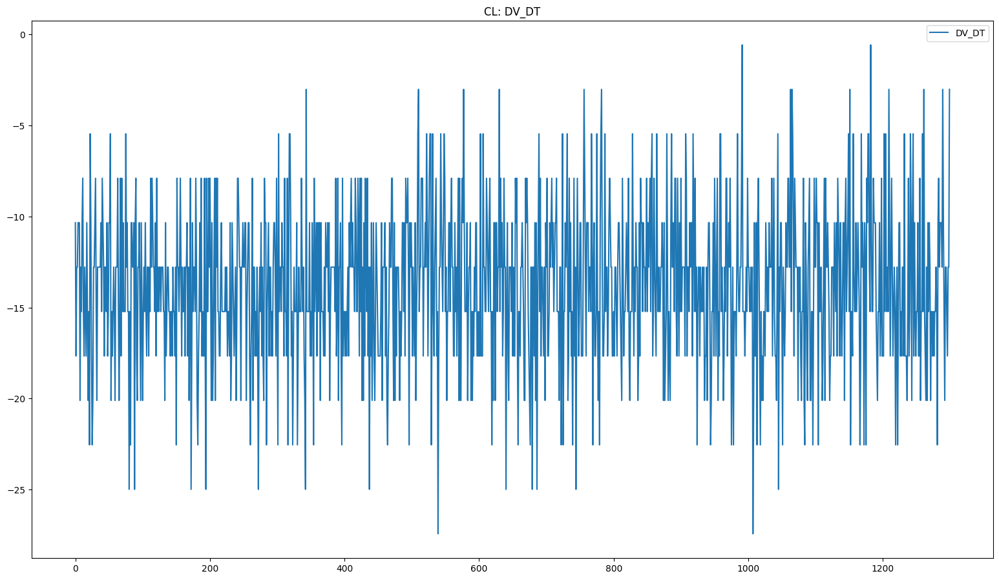

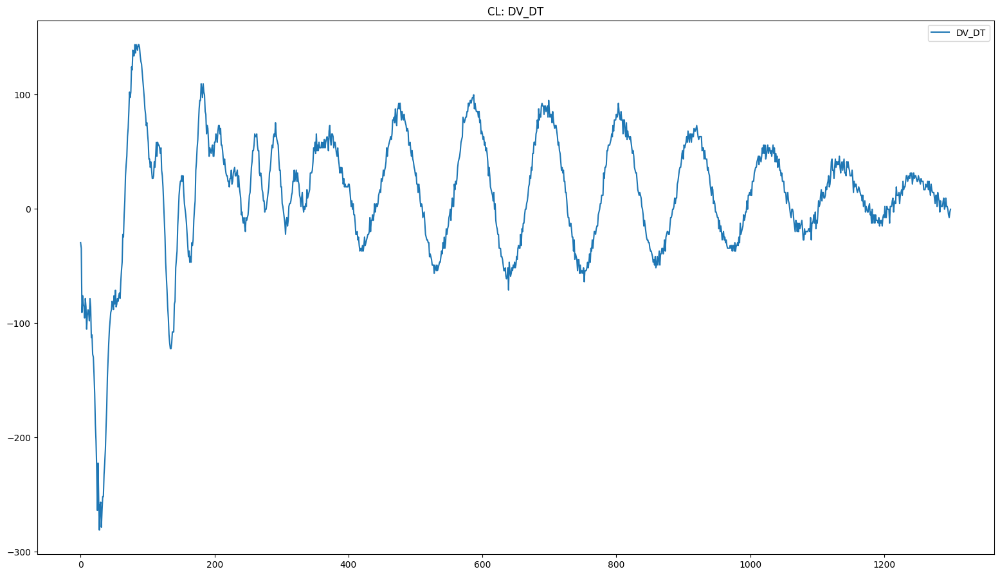

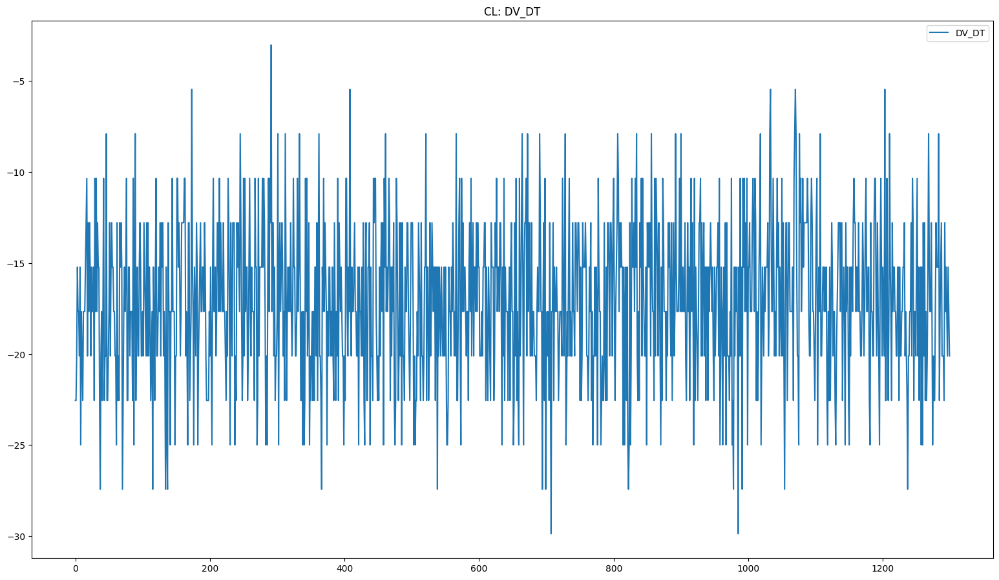

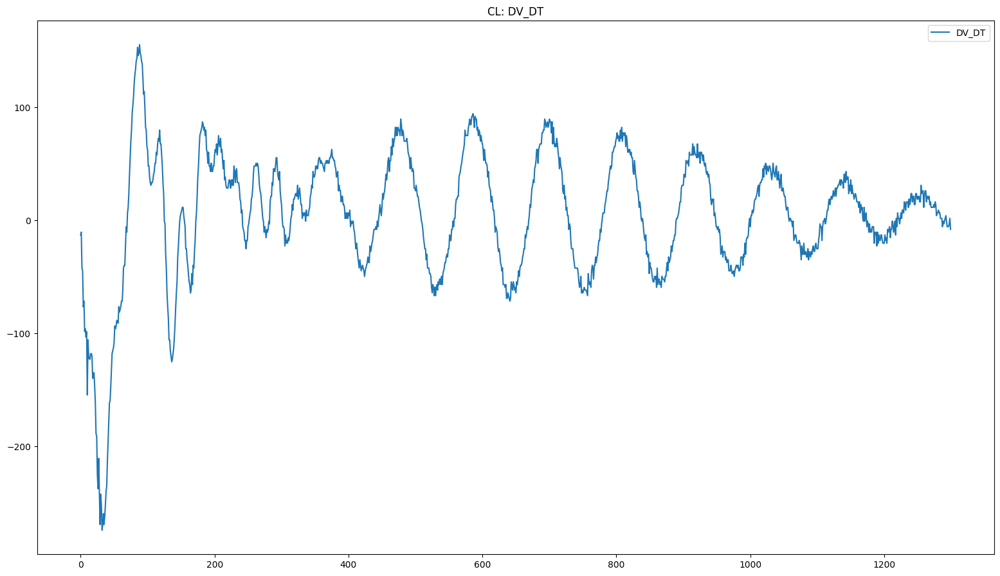

In [36]:
RFQ_Y_pd = pd.DataFrame(RFQ_Y,columns=["name", "status", "reason"])
# 690

# len(RFQ_X)
original_features = ["A_IGBT_I", "A_starIGBT_I", "B_IGBT_I", "B_starIGBT_I",
                     "C_IGBT_I", "C_starIGBT_I", "A_Flux", "B_Flux", "C_Flux",
                     "Mod_V", "Mod_I", "CB_I", "CB_V", "DV_DT"]    
for cl in original_features:
    for i in range(860,871, 1):
        x = RFQ_X[i][3200:,:]
        
        tmp = pd.DataFrame(x, columns=original_features)[[cl]].reset_index(drop=True)

        px = 1/plt.rcParams['figure.dpi']

        fig, ax = plt.subplots(figsize=(1920*px, 1080*px))
        fig.patch.set_facecolor((1,1,1,1))
        fig.patch.set_alpha(1.0)

        # plt.plot(CCL_X_all.iloc[limx:limy,0], )
        sns.lineplot(data=tmp).set_title(f"CL: {cl}")

        plt.show()

In [11]:
limx = 0
limy = len(CCL_X_all)
px = 1/plt.rcParams['figure.dpi']

fig, ax = plt.subplots(figsize=(7840*px, 1080*px))
fig.patch.set_facecolor((1,1,1,1))
fig.patch.set_alpha(1.0)

# plt.plot(CCL_X_all.iloc[limx:limy,0], )
sns.lineplot(data=CCL_X_all[CCL_X_all["pulse_status"]==0], x=CCL_X_all[CCL_X_all["pulse_status"]==0].index, y='a', color="blue")
sns.lineplot(data=CCL_X_all[CCL_X_all["pulse_status"]==1].reset_index(drop=True), x=CCL_X_all[CCL_X_all["pulse_status"]==1].reset_index(drop=True).index, y='a', color="red")
plt.savefig("aaaa.png", bbox_inches='tight')

plt.show()

KeyboardInterrupt: 

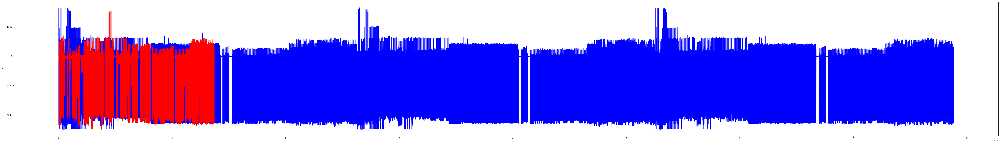

In [15]:
limx = 0
limy = len(CCL_X_all)
px = 1/plt.rcParams['figure.dpi']

fig, ax = plt.subplots(figsize=(7840*px, 1080*px))
fig.patch.set_facecolor((1,1,1,1))
fig.patch.set_alpha(1.0)

# plt.plot(CCL_X_all.iloc[limx:limy,0], )
sns.lineplot(data=CCL_X_all[CCL_X_all["pulse_status"]==0], x=CCL_X_all[CCL_X_all["pulse_status"]==0].index, y='a', color="blue")
sns.lineplot(data=CCL_X_all[CCL_X_all["pulse_status"]==1].reset_index(drop=True), x=CCL_X_all[CCL_X_all["pulse_status"]==1].reset_index(drop=True).index, y='a', color="red")
plt.savefig("aaaa2.png", bbox_inches='tight')

plt.show()

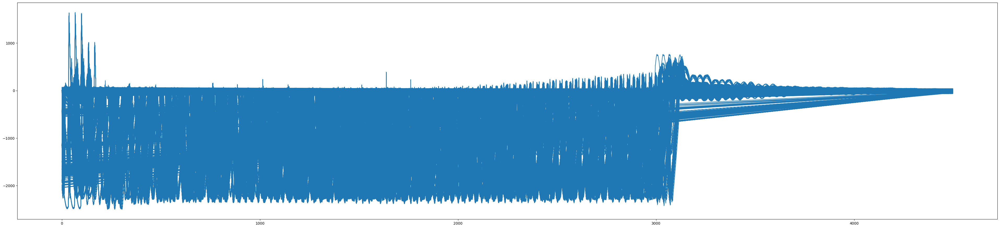

In [7]:
px = 1/plt.rcParams['figure.dpi']

fig = plt.figure(figsize=(5840*px, 1080*px))
fig.patch.set_facecolor((1,1,1,1))
fig.patch.set_alpha(1.0)

plt.plot(CCL_X_all.iloc[:,0])
plt.savefig("aaaa.png", bbox_inches='tight')

In [ ]:
px = 1/plt.rcParams['figure.dpi']

fig = plt.figure(figsize=(3840*px, 2160*px))
fig.patch.set_facecolor((1,1,1,1))
fig.patch.set_alpha(1.0)

plt.plot(CCL_X_all.iloc[:,0])
plt.savefig("aaaa.png", bbox_inches='tight')

## Anomaly detection

t1=400

In [5]:
df = result["anomalous_stream"]

In [6]:
import report_utils
import pandas as pd
import numpy as np
import os
from sklearn.metrics import roc_auc_score, f1_score
import time
from tqdm import tqdm
import ready_pipelines
import tensorflow as tf
import random 
import multiprocessing
import logging
from pathlib import Path
from IPython.display import clear_output

In [7]:
df = result["anomalous_stream"]

In [8]:
def set_random(seed_value):
    # 1. Set `PYTHONHASHSEED` environment variable at a fixed value
    os.environ['PYTHONHASHSEED']=str(seed_value)
    # 2. Set `python` built-in pseudo-random generator at a fixed value
    random.seed(seed_value)
    # 3. Set `numpy` pseudo-random generator at a fixed value
    np.random.seed(seed_value)
    # 4. Set `tensorflow` pseudo-random generator at a fixed value
    tf.random.set_seed(seed_value)

In [9]:
def driver_func(runnable_pipe_func, SAVE_FOLDER, nr_subsets, nr_percentage, family_descr, N_ESTIMATORS, N_CORES, data_df, random_seeds):

    with multiprocessing.Pool(N_CORES) as pool:
        results = [pool.apply_async(runnable_pipe_func, (SAVE_FOLDER, nr_subsets, nr_percentage, str(family_descr), f"task_model_{str(task_ind).rjust(3,'0')}",data_df, seed)) for task_ind, seed in zip(range(N_ESTIMATORS), random_seeds)]
        
        all_seeds = []
        count = 0
        for r in tqdm(results, f"task_model_{str(count).rjust(3,'0')}"):
            tmp_res = r.get()
            all_seeds.append(tmp_res)
            count+=1
    
    return all_seeds

In [10]:
data_df = df
for nr_subsets in [2]:#[2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]:
    nr_subsets_ind = str(nr_subsets)
    for nr_percentage in [0.75]:#[0.75, 0.70, 0.65, 0.60]:
        nr_percentage_ind = str(nr_percentage).replace("0","").replace(".","").ljust(2,'0')
        for N_ESTIMATORS in [9]:#[11,13,15,17,19,21,23,25]:
            for tmp_seed_number in [2]:#range(1,35,1):
                print(tmp_seed_number)
                # N_ESTIMATORS = 61
                N_CORES = 11
                SAVE_FOLDER = f"./tmp_res_{N_ESTIMATORS}_{str(nr_subsets_ind)}_{nr_percentage_ind}"
                
                set_random(tmp_seed_number)
                Path(SAVE_FOLDER).mkdir(parents=True, exist_ok=True)

                log = logging.getLogger()
                for hdlr in log.handlers[:]:
                    log.removeHandler(hdlr)
                
                logging.basicConfig(level=logging.INFO, filename=f"{SAVE_FOLDER}/logs_info.log",
                                    format="CREATED_AT: %(asctime)s - MESSAGE: %(message)s")


                random_seeds = np.random.choice(9999, N_ESTIMATORS, replace=False).tolist()
                logging.info(f"'Params: N_ESTIMATORS: {N_ESTIMATORS} nr_subsets: {str(nr_subsets)} nr_percentage: {str(nr_percentage)} general_seed: {str(tmp_seed_number)} other_seeds: [{str(random_seeds)}]'")

                res = driver_func(ready_pipelines.run_pipeline_conv_ae_for_new_data_1, SAVE_FOLDER, 2, nr_percentage, str(tmp_seed_number), N_ESTIMATORS, N_CORES, data_df, random_seeds)

                time.sleep(10)
                
                df = report_utils.family_majority_voting(top_level_folder=SAVE_FOLDER, model_family=f"family_conv_ae_{str(tmp_seed_number)}")
                df = df[["predicted_anomaly_majority_voting"]]

                # df_original = pd.concat(data_df,ignore_index=False)
                # df_original = df_original[["anomaly"]]

                final_df = pd.concat([df,data_df], ignore_index=False, axis=1)
                # roc_number = roc_auc_score(final_df["anomaly"], final_df["predicted_anomaly_majority_voting"])
                # F1 = f1_score(final_df["anomaly"], final_df["predicted_anomaly_majority_voting"])

                # clear_output(wait=True)

                # logging.info(f"'AUC: {roc_number} F1: {F1}")
                
                # if roc_number>0.8300:
                #     break

2


task_model_000: 100%|██████████| 9/9 [00:51<00:00,  5.74s/it]

Index should not be repeated. Check your files


Dataset: 100%|██████████| 1/1 [00:00<00:00, 71.25it/s]
Model: 9it [00:00, 53.99it/s]


In [11]:
final_df

,predicted_anomaly_majority_voting,X1.1365e.07,X1.1585e.07,X1.1777e.07,X1.2246e.07,X1.2786e.07,X1.2318e.07,X1.1959e.07,X1.217e.07,X1.2249e.07,...,X1.143e.07.2,X1.1484e.07.1,X1.1518e.07.2,X1.1561e.07.3,X1.1409e.07.2,X1.1264e.07.1,X1.1184e.07,X1.1176e.07,X1.1239e.07.2,X1.1195e.07
0,0,8053.2,15046.00,7227.40,9413.1,13797.0,7659.0,6383.2,9135.3,8213.4,...,5068.6,5510.6,5800.3,5423.2,4915.9,4271.80,4168.60,4152.20,4322.00,4223.40
1,0,3839.9,9650.90,3367.30,4352.4,6419.0,2614.9,1682.7,4043.3,3115.3,...,1363.3,1646.1,1787.5,1548.2,1271.2,553.33,261.27,232.03,382.45,195.45
2,0,6354.6,12059.00,3058.50,3611.8,7126.3,3074.0,1680.1,3257.5,2884.4,...,1145.8,1642.4,1654.1,2177.3,1390.8,498.95,272.90,162.81,476.21,264.59
3,0,9486.7,14697.00,3444.70,2757.3,6123.1,2821.4,1672.0,3995.9,2273.7,...,1594.3,1997.1,2455.5,2596.3,1570.7,688.66,343.32,250.19,513.09,196.97
4,0,8064.8,12649.00,3204.90,3790.0,7702.2,2181.2,3407.9,2186.0,2564.5,...,1132.8,2283.9,2365.8,2103.5,1272.7,570.49,315.49,218.59,439.14,264.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454,0,8864.4,11110.00,12013.00,22558.0,20930.0,5982.1,6525.2,3451.1,13167.0,...,4834.7,4321.8,3528.7,2229.5,2111.2,1746.10,1617.70,1773.20,1186.90,1015.10
1455,0,5505.7,4937.50,3843.30,12575.0,12328.0,3475.3,5284.9,5572.3,7354.1,...,4684.8,3911.0,4221.4,2512.4,2615.6,1869.30,2031.20,1904.60,1024.70,730.99
1456,0,5913.4,3810.90,2690.20,9974.7,6262.2,2369.1,3212.6,5958.5,8522.7,...,4791.9,4215.6,4161.9,2491.0,2198.8,1806.80,1526.10,2241.90,1407.50,804.59
1457,0,4420.5,2393.50,1599.80,5851.5,4720.4,2023.0,4149.9,5868.3,4152.9,...,4067.2,3897.9,3810.2,2187.5,3118.1,1821.30,2208.90,1599.90,1192.60,825.49


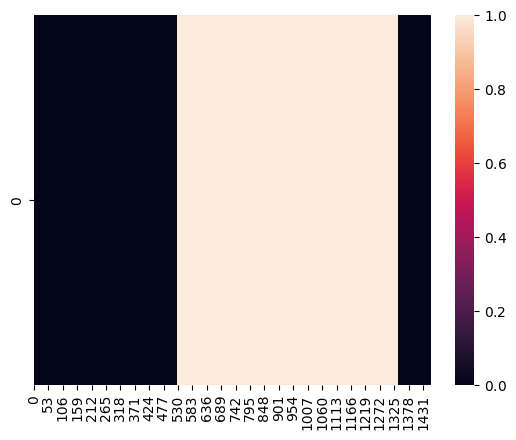

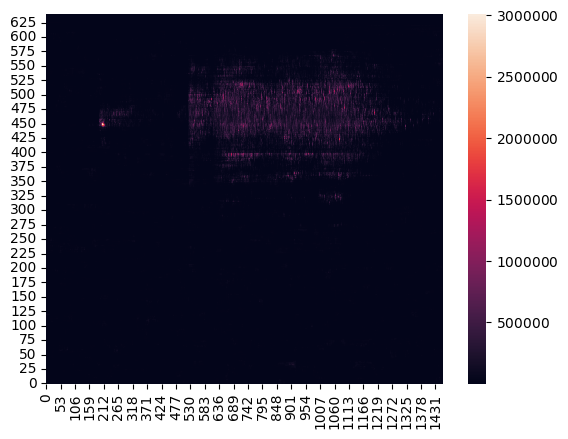

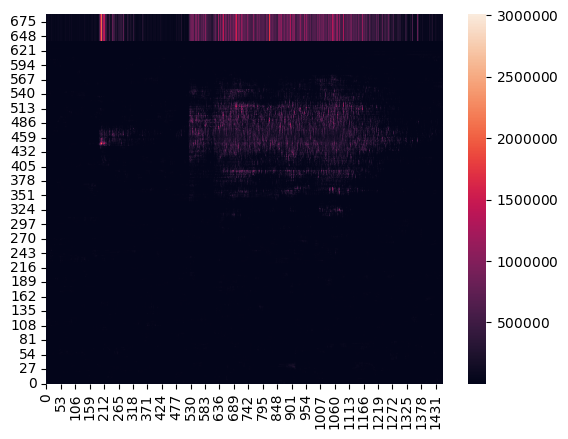

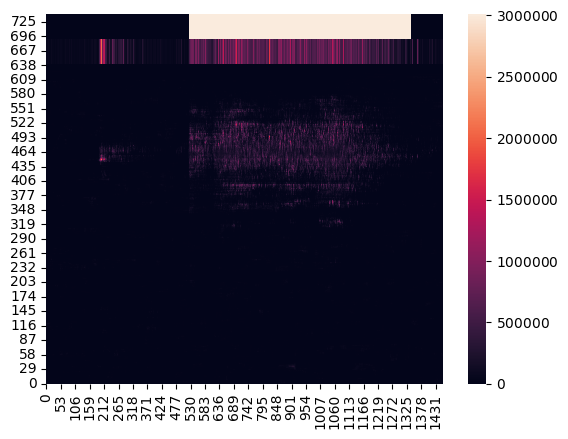

In [29]:
aaaa = final_df[["predicted_anomaly_majority_voting"]].copy(deep=True)

import matplotlib.ticker as tkr
formatter = tkr.ScalarFormatter(useMathText=True)
formatter.set_scientific(False)

data = []
cols = [i for i in range(1459)]
for ind, col in enumerate(aaaa.columns.to_list()):
    data.append(aaaa[col].to_list())

df_tmp = pd.DataFrame(data,columns=cols)
sns.heatmap(df_tmp, fmt='g', cbar_kws={'format':formatter}).invert_yaxis()
plt.show()

aaaa = final_df.drop(["predicted_anomaly_majority_voting"], axis=1).copy(deep=True)

import matplotlib.ticker as tkr
formatter = tkr.ScalarFormatter(useMathText=True)
formatter.set_scientific(False)

data = []
cols = [i for i in range(1459)]
for ind, col in enumerate(aaaa.columns.to_list()):
    data.append(aaaa[col].to_list())

df_tmp = pd.DataFrame(data,columns=cols)
sns.heatmap(df_tmp, fmt='g', cbar_kws={'format':formatter}).invert_yaxis()
plt.show()

aaaa = final_df.drop(["predicted_anomaly_majority_voting"], axis=1).copy(deep=True)
hmapsize = 50
for hmapsize_i in range(hmapsize):
    aaaa[f"asd_{hmapsize_i}"] = aaaa.max(axis=1)

import matplotlib.ticker as tkr
formatter = tkr.ScalarFormatter(useMathText=True)
formatter.set_scientific(False)

data = []
cols = [i for i in range(1459)]
for ind, col in enumerate(aaaa.columns.to_list()):
    data.append(aaaa[col].to_list())

df_tmp = pd.DataFrame(data,columns=cols)
sns.heatmap(df_tmp, fmt='g', cbar_kws={'format':formatter}).invert_yaxis()
plt.show()

aaaa = final_df.copy(deep=True)
hmapsize = 50
for hmapsize_i in range(hmapsize):
    aaaa[f"asd_{hmapsize_i}"] = aaaa.max(axis=1)

hmapsize = 50
max_final_df_number = final_df.max().max()
min_final_df_number = final_df.min().min()
aaaa[[f"asdasd_{hmapsize_i}" for hmapsize_i in range(hmapsize)]] = final_df.apply(lambda x: [max_final_df_number for hmapsize_i in range(hmapsize)] if x.predicted_anomaly_majority_voting > 0.5 else [min_final_df_number for hmapsize_i in range(hmapsize)], axis=1, result_type='expand')

import matplotlib.ticker as tkr
formatter = tkr.ScalarFormatter(useMathText=True)
formatter.set_scientific(False)

data = []
cols = [i for i in range(1459)]
for ind, col in enumerate(aaaa.columns.to_list()):
    data.append(aaaa[col].to_list())

df_tmp = pd.DataFrame(data,columns=cols)
sns.heatmap(df_tmp, fmt='g', cbar_kws={'format':formatter}).invert_yaxis()
plt.show()